# NASA Earth Exchange (NEX) Downscaled Climate Projections (NEX-DCP30) dataset for the conterminous United States

The modelled data generated from the General Circulation Model(GCM) runs under 33 different Coupled Model Intercomparison Project Phase 5(CMIP5) models. The modelled data projections are available for four greenhouse gas emissions scenarios known as Representative Concentration Pathways(RCPs) labelled after the range of radiative forcing values in the year 2100 (2.6, 4.5, 6, and 8.5 W/m2).

In this notebook we will be building on our python skills by first extracting and plotting a time series for Santa Barbara city. Then we will expand to more advanced mapping using Santa Barbara county as region of interest. The climate dataset is available for four Representative Concentration Pathways(RCPs) but we will be using RCP8.5 as our example. Our variables of interest are precipitation and temperature as modelled for the future. This modelling is vital for county governments and economy sectors to begin planning for climate change and understanding how it may effect them directly.

The contents of this notebook can be easily modified to work with any region of the NEX DCP30 US dataset for any of the available RCPs.

## Authors

- Desik Somasundaram, UC Santa Barbara (desik@bren.ucsb.edu ) <br>
- Daniel Kerstan, UC Santa Barbara (danielkerstan@bren.ucsb.edu ) <br>
- Joe DeCesaro, UC Santa Barbara (jdecesaro@bren.ucsb.edu ) <br>

## Table of Contents
The notebook is structured to start with the specified purpose and describe the key characteristics NASA Earth Exchange (NEX) Downscaled Climate Projections (NEX-DCP30) dataset for the conterminous United States.

The data I/O section sets up the kernel with required packages and reads in the dataset.

The metadata display and basic visualization focus on the point data time series visualization while the advanced visualization focuses on regional time series. 

The use case examples will be based off the regional time series visualizations. 
Binder environment and references are provided. 

[1. Purpose](#purpose)

[2. Dataset Description](#overview)

[3. Data I/O](#io)

[4. Metadata Display and Basic Visualization](#display)

[5. Advanced Visualization](#advanceddisplay)

[6. Use Case Examples](#usecases)

[7. Create Binder Environment](#binder)

[8. References](#references)

<a id='purpose'></a> 
## Notebook Purpose

Climate change remains to be one of the most critical issues facing the United States today.
Climate action requires thoughtful policy-making from local and county governments all the way up to the national level. This notebook is a tutorial on leveraging the NEX-DCP30 dataset developed by NASA Earth Exchange for local climate action. The goal is to  inform policymakers and government officials with tangible insights on potential impacts.  

This notebook was produced for the final project of EDS 220 - Remote Sensing. It provides instruction and example code on how to pull in the NASA Earth Exchange climate projection data directly from the source. It provides specific use case examples for Santa Barbara county. Specifically, this workbook shows how local governments and economy sectors could plan for different climate scenarios from the dataset.


<a id='overview'></a> 
## Dataset Description

### General Description
The modelled data is generated by NASA from the General Circulation Model(GCM) runs under 33 different Coupled Model Intercomparison Project Phase 5(CMIP5) models. The modelled data projections are available for four greenhouse gas emissions scenarios known as Representative Concentration Pathways(RCPs) labelled after the range of radiative forcing values in the year 2100 (2.6, 4.5, 6, and 8.5 W/m2). The 2.6 W/m2 scenario is the least extreme and the 8.5 W/m2 scenario is the most extreme.

- Precipitation data is provided as a monthly mean of the daily precipitation rate in units of kg/m2s
- Temperature data is provided as a monthly mean of the daily predicted temperature in units of degrees K

### Coverage
The data spatially covers the contiguous US at a spatial resolution of 30 arc-seconds/0.00833 degrees (approximately 800 meters). The temoporal coverage of the data is made up of a "Retrosoective Run" (1950-2005), and a "Prospective Run" (2006-2099).

### File Format
Data is in netcdf files. It contains the following information:
- One monthly averaged value for each month from 2006 to 2099
- Monthly average can be based off of daily min, max, average and quartiles for each constituent
- The openDAP access allows you to subset the variables, region and time extent of your interest.

### Retrieval
In this example, dataset will be accessed through the THREDDS OpenDAP services to avoid download of large files in repo. However, there are many other way to access the data including options such as Netcdfsubset.
https://www.nccs.nasa.gov/services/data-collections/land-based-products/nex-dcp30

### Assumptions
Relative spatial patterns in temperature and precipitation observed from 1950 through 2005 will remain constant under future climate change. 

Does not add information beyond what is contained in the original CMIP5 scenarios, and preserves the frequency of periods of anomalously high and low temperature or precipitation (i.e., extreme events) within each individual CMIP5 scenario.

### Bias Correction-Spatial Disaggregation (BSCD)
***Problem: Biased data unsuitable for local level decision making.*** 

Original GCM model runs are run at coarse resolution which is not at the level of detail required for local decision making. In addition, although the projections are globally accurate there may be considerable bias at the local level since it does not take into account local topography.

***Solution: BSCD using PRISM (observational climate data from meteorological stations)***

The Bias-Correction step corrects the bias of the GCM data through comparisons performed against the observationally-based PRISM data.
The Spatial-Disaggregation step spatially interpolates the bias-corrected GCM data to the finer resolution grid of the 30-arc second PRISM data.

<a id='io'></a> 
## Dataset Input/Output 

1) Import all necessary packages (matplotlib, numpy, etc)

In [1]:
import numpy as np
import scipy
import scipy.ndimage as ndimage
import scipy.stats as stats
import matplotlib.pyplot as plt
import xarray as xr
import cartopy
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.feature import NaturalEarthFeature
import geopandas as gpd
import metpy
from metpy.units import units
import pandas as pd
import plotly.express as px

2) Set parameters needed

In [2]:
# - names of any directories where data are stored
# - ranges of years over which data are valid
# - any thresholds or latitude/longitude ranges to be used later (e.g. dimensions of NINO3.4 region, threshold SSTA values for El Nino, etc.)
# Read in Santa Barbara County shapefile (Area of Interest)
sb_county = gpd.read_file('tl_2019_06083_faces/tl_2019_06083_faces.shp')

xmin, ymin, xmax, ymax = sb_county.total_bounds
# Convert x bounds to 0 to 360 format to match netcdf format
xmin_shift = xmin + 360
xmax_shift = xmax + 360

3) Read in data

In [3]:
# location of NEXDCP30 data
nexdcp_url="https://ds.nccs.nasa.gov/thredds/dodsC/bypass/NEX-DCP30/nex-quartile/rcp85/r1i1p1.ncml"
# open dataset using remote URL
nexdcp_rcp85_xr=xr.open_dataset(nexdcp_url)

<a id='display'></a> 
### Metadata Display and Basic Visualization
**Using Santa Barbara City as Point Location Example**

Take a look at the dataset along with it's metadata

In [4]:
# Metadata Display
nexdcp_rcp85_xr

<xarray.Dataset>
Dimensions:            (lat: 3105, lon: 7025, bnds: 2, time: 1128)
Coordinates:
  * lat                (lat) float64 24.06 24.07 24.08 ... 49.91 49.92 49.93
  * lon                (lon) float64 235.0 235.0 235.0 ... 293.5 293.5 293.5
  * time               (time) datetime64[ns] 2006-01-16T12:00:00 ... 2099-12-...
Dimensions without coordinates: bnds
Data variables: (12/15)
    lat_bnds           (lat, bnds) float64 ...
    lon_bnds           (lon, bnds) float64 ...
    time_bnds          (time, bnds) float64 ...
    ens-avg_pr         (time, lat, lon) float32 ...
    ens-avg_tasmax     (time, lat, lon) float32 ...
    ens-avg_tasmin     (time, lat, lon) float32 ...
    ...                 ...
    quartile50_pr      (time, lat, lon) float32 ...
    quartile50_tasmax  (time, lat, lon) float32 ...
    quartile50_tasmin  (time, lat, lon) float32 ...
    quartile75_pr      (time, lat, lon) float32 ...
    quartile75_tasmax  (time, lat, lon) float32 ...
    quartile75_tasmin  (time, lat, lon) float32 ...
Attributes: (12/39)
    CDI:                            Climate Data Interface version 1.5.5 (htt...
    parent_experiment:              historical
    parent_experiment_id:           historical
    parent_experiment_rip:          r1i1p1
    creation_date:                  Mon Jul 23 02:05:29 PDT 2012
    CDO:                            Climate Data Operators version 1.5.5 (htt...
    ...                             ...
    title:                          800m Downscaled NEX CMIP5 Climate Project...
    contact:                        Dr. Rama Nemani: rama.nemani@nasa.gov, Dr...
    model_id:                       NEX-quartile
    references:                     BCSD method: Wood AW, Maurer EP, Kumar A,...
    DOI:                            http://dx.doi.org/10.7292/W0WD3XH4
    experiment:                     RCP8.5

**Selecting Santa Barbara city as our point of interest**

In [5]:
# Select a single x,y combination closest to Santa Barbara city location
# ideally we would write a function that identifies the closest keys based on lat lon input
# in this case the keys(grid cell numbers) are provided
key1=639
key2=1243
longitude = nexdcp_rcp85_xr["ens-avg_tasmax"]["lon"].values[key1]
latitude = nexdcp_rcp85_xr["ens-avg_tasmax"]["lat"].values[key2]

print("Long, Lat values:", longitude, latitude)

Long, Lat values: 240.30416666454 34.42083332919


In [6]:
# Slice the data spatially using a single lat/lon point
start_date = "2022-01-15"
end_date = "2099-12-15"
sb_max_temp = nexdcp_rcp85_xr["ens-avg_tasmax"].sel(time=slice(start_date, end_date),
                                                lat=latitude,
                                                lon=longitude)
sb_avg_precip = nexdcp_rcp85_xr["ens-avg_pr"].sel(time=slice(start_date, end_date),
                                                lat=latitude,
                                                lon=longitude)

**Data Wrangling Xarrays to get more visualization friendly format**

In [7]:
# Convert deg K to deg F
sb_max_temp = sb_max_temp.metpy.convert_units('degF')

In [8]:
# Make metpy recognize the units
sb_avg_precip = sb_avg_precip.metpy.quantify()

In [9]:
# convert kg*m2/sec to in/yr
density_water = units('kg / m^3') * 1000
sb_avg_precip_converted_int = (sb_avg_precip / density_water)
sb_avg_precip_converted = sb_avg_precip_converted_int.metpy.convert_units('inches / year')  

In [10]:
# convert xarray array to xarray dataset
sb_max_temp_ds = sb_max_temp.to_dataset()
sb_avg_precip_ds = sb_avg_precip_converted.to_dataset()
# convert xarray dataset to pandas df
temp_df = sb_max_temp_ds.to_pandas()
precip_df = sb_avg_precip_ds.to_pandas()
# convert time into a column from index
temp_df['time'] = temp_df.index
# drop lat lon since we extracted for a point
temp_df.drop(['lat','lon'], axis=1, inplace=True)
precip_df.drop(['lat','lon'], axis=1, inplace=True)

In [11]:
# Resample monthly data to yearly sum
precip_yearly = precip_df.resample('Y').mean()
precip_yearly['time'] = precip_yearly.index

**Visualizations**

Basic

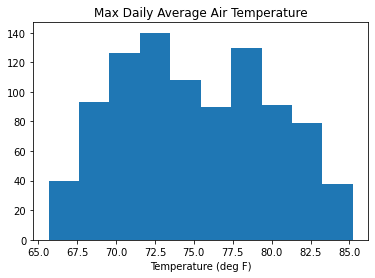

In [12]:
# Plot a quick histogram of temperature
sb_max_temp.plot.hist()
plt.title("Max Daily Average Air Temperature")
plt.xlabel('Temperature (deg F)')
plt.show()

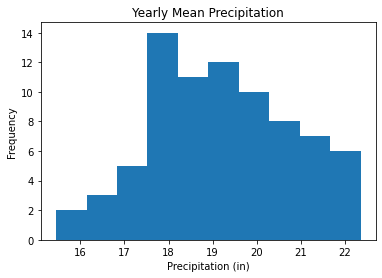

In [13]:
# Plot a quick histogram of precipitation
precip_yearly["ens-avg_pr"].plot.hist()
plt.title("Yearly Mean Precipitation")
plt.xlabel('Precipitation (in)')
plt.show()

Interactive

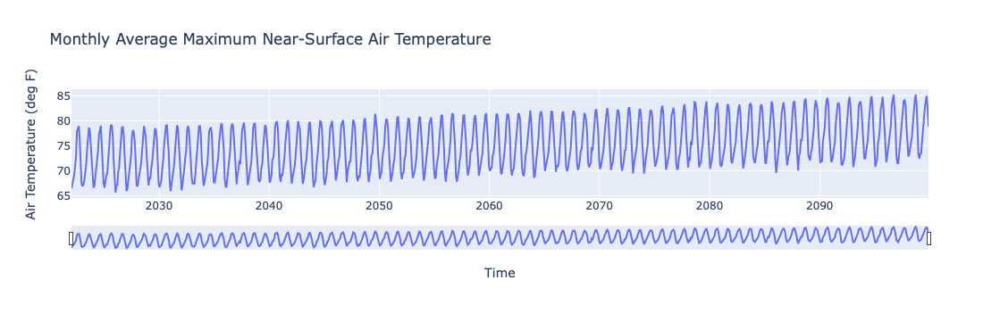

In [14]:
# Time series plot of max air temperature
fig = px.line(temp_df, x="time", y="ens-avg_tasmax", labels={
                     "time": "Time",
                     "ens-avg_tasmax": "Air Temperature (deg F)"},
              title="Monthly Average Maximum Near-Surface Air Temperature")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

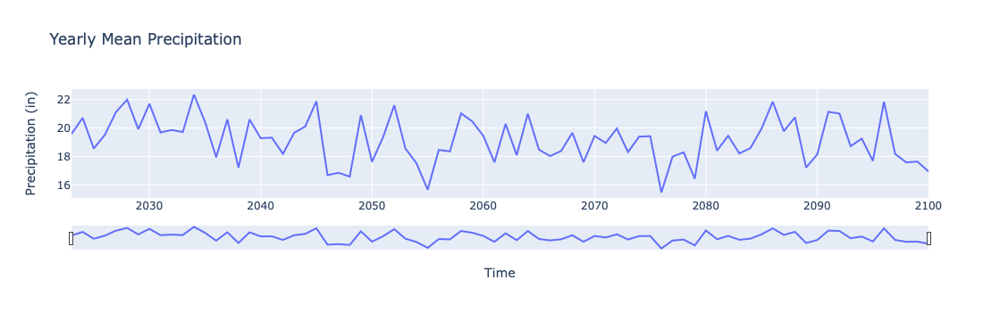

In [15]:
# Time series plot of average precipitation for year (in/yr)
fig = px.line(precip_yearly, x="time", y="ens-avg_pr", labels={
                     "time": "Time",
                     "ens-avg_pr": "Precipitation (in)"},
              title="Yearly Mean Precipitation")
fig.update_xaxes(rangeslider_visible=True)
fig.show()

<a id='advanceddisplay'></a> 
### Advanced Visualization
**Using Santa Barbara County as Region Example**

**Take a look at time extent of data**

In [16]:
# View date range
print("The earliest date in the data is:", nexdcp_rcp85_xr["ens-avg_tasmax"]["time"].values.min())
print("The latest date in the data is:", nexdcp_rcp85_xr["ens-avg_tasmax"]["time"].values.max())  

The earliest date in the data is: 2006-01-16T12:00:00.000000000
The latest date in the data is: 2099-12-16T12:00:00.000000000


**Select the Santa Barbara County of a ROI**

In [17]:
# Specify time extent of interest
start_date = "2022-01-15"
end_date = "2032-12-15"


In [18]:
# Slice the data by time and spatial extent
# Note that we used the shapefile to specify the extent of our region of interest
sb10_temp = nexdcp_rcp85_xr["ens-avg_tasmax"].sel(
    time=slice(start_date, end_date),
    lon=slice(xmin_shift, xmax_shift),
    lat=slice(ymin, ymax))

In [19]:
# Repeat for precipitation
sb10_precip = nexdcp_rcp85_xr["ens-avg_pr"].sel(
    time=slice(start_date, end_date),
    lon=slice(xmin_shift, xmax_shift),
    lat=slice(ymin, ymax))

**Data Wrangling Xarrays to get more visualization friendly units**

In [20]:
# Convert deg K to deg F
sb10_temp_degf = sb10_temp.metpy.convert_units('degF')

In [21]:
# Make metpy recognize the units
sb10_precip = sb10_precip.metpy.quantify()

In [22]:
# convert kg*m2/sec to in/yr
density_water = units('kg / m^3') * 1000
sb10_precip_converted_int = (sb10_precip / density_water)
sb10_precip_converted = sb10_precip_converted_int.metpy.convert_units('inches / year') 
sb10_precip_converted

Magnitude,[[[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [43.28982162475586 43.288169860839844 43.31467056274414 ... 13.314281463623047 13.32544994354248 13.350573539733887] [43.26180648803711 42.707618713378906 43.316162109375 ... 12.806041717529297 13.335638999938965 13.31904411315918] [42.69291305541992 43.2982292175293 43.33096694946289 ... 12.801080703735352 12.795879364013672 13.293975830078125]] [[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [49.57374954223633 49.59160614013672 49.531410217285156 ... 16.718076705932617 16.769601821899414 16.81549835205078] [50.124237060546875 49.51312255859375 50.10813903808594 ... 16.691808700561523 16.717876434326172 16.76471519470215] [50.05524444580078 50.006629943847656 50.028507232666016 ... 15.756314277648926 15.802470207214355 16.72651481628418]] [[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [25.593002319335938 25.61248779296875 25.624832153320312 ... 11.213765144348145 11.615740776062012 11.642353057861328] [25.59810447692871 25.60989761352539 25.62809944152832 ... 11.210569381713867 11.221519470214844 11.259154319763184] [25.596111297607422 25.6423397064209 25.585668563842773 ... 10.966299057006836 11.245573043823242 11.268998146057129]] ... [[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [4.924160480499268 4.933640480041504 4.94359827041626 ... 4.88932991027832 4.893035888671875 4.906702518463135] [4.913969993591309 4.915413856506348 4.950366497039795 ... 4.853913307189941 4.865774631500244 4.881140232086182] [4.914044380187988 4.924771308898926 4.939178943634033 ... 4.863954067230225 4.847743988037109 4.872461318969727]] [[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [9.195388793945312 9.203600883483887 9.209125518798828 ... 5.222756862640381 5.2183613777160645 5.237492084503174] [9.184609413146973 9.197802543640137 9.20293140411377 ... 4.694159984588623 4.662483215332031 5.212801933288574] [9.153992652893066 9.185802459716797 9.213177680969238 ... 4.667502403259277 4.6707305908203125 4.638547420501709]] [[nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] [nan nan nan ... nan nan nan] ... [19.87596893310547 19.9024600982666 19.924348831176758 ... 7.02076530456543 7.0245361328125 7.554636001586914] [19.85515785217285 19.89241600036621 19.91830062866211 ... 7.003170013427734 7.019637584686279 7.000521659851074] [19.849946975708008 19.865249633789062 19.890531539916992 ... 7.019983291625977 7.015469074249268 7.022475242614746]]]
Units,inch/year


In [23]:
# Convert to dataset format to resample and get yearly precipitation estimates
sb10_precip_converted_ds = sb10_precip_converted.to_dataset()
sb10_precip_yearly = sb10_precip_converted_ds["ens-avg_pr"].resample(time='Y').mean()

<a id='usecases'></a> 
### Use Case Examples

### Use Case 1: Protecting your county from heat

Congratulations!! You are part of the Santa Barbara County Climate Change Task Force (SBCCCTF). You have been hired to use data analysis to determine the areas where temperature increase will occur most drastically in the county for X, y, and z years. You are charged with making a map that shows the temperature increases. 

This analysis and map will be critical to determine which areas will be most susceptible to heat waves in the future. County and city officials will use your analysis to determine the most vulnerable populations in the county to heat waves. Your analysis will help save lives as there are more extreme heat events in the future.

Air Temperature Advanced Visualization

In [24]:
# Load xarray from dataset included in the xarray tutorial
# COMMENTED TO REDUCE FILE SIZE: Uncomment these for visualization
#fig = px.imshow(sb10_temp_degf, animation_frame='time',zmin=40, zmax=120, 
#                color_continuous_scale="jet", origin='lower',
#                title="SB County Monthly Average Maximum Near-Surface Air Temperature",
#                width=700, height=500)
#fig.update_layout(margin=dict(l=20, r=20, t=50, b=10))
#fig.show()

We now know that the x, y, and z areas of a county will be most vulnerable to increasing temperatures in the future. Further analysis should include looking at previous heat wave events and determining patterns of health issues related to the events. City data could be used to find suitible buildings to be set up as cooling shelters during these events for those that do not have air conditioning.

### Use case 2: You are a big shot wine investor.

Grapevines can be used to make wine for decades and even as long as 100 years! You, a big shot wine investor want to make sure that your investment will be protected from climate change. To protect and plan for climate change you want to determine how predicted rainfall will change throughout your favorite region, Santa Barbara County.

To conduct this analysis you will make a map of the region and determine the predicted total rainfall for years x, y, and z. This information will then be provided to your growers in the region to determine whether they will need to plan for reduced, increased, or stagnant rainfalls. With this information they will tell you whether your current grapes will be climate change resilient or whether or not you should consider planting different types of grapes.

Precipitation Advanced Visualization

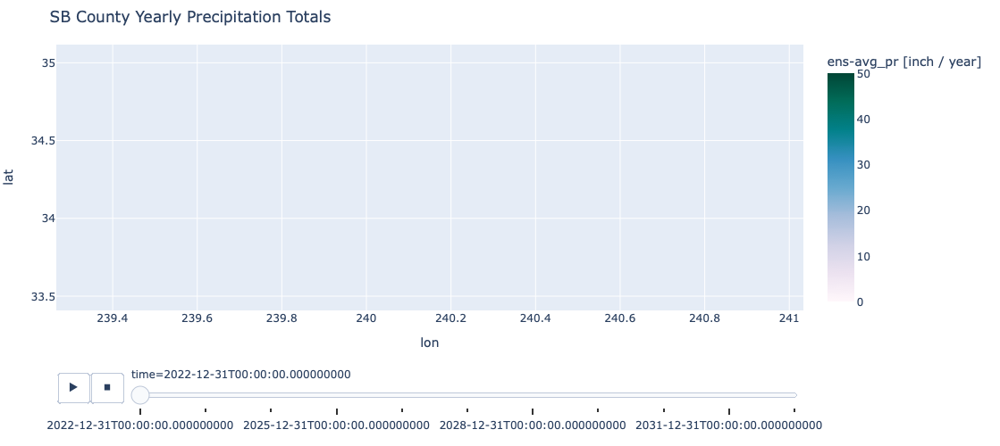

In [25]:
# Load xarray from dataset included in the xarray tutorial
# COMMENTED TO REDUCE FILE SIZE: Uncomment these for visualization
#fig = px.imshow(sb10_precip_yearly, animation_frame='time',zmin=0, zmax=50, 
#                color_continuous_scale="PuBuGn", origin='lower',
#                title="SB County Yearly Precipitation Totals",
#                width=700, height=500)
#fig.update_layout(margin=dict(l=20, r=20, t=50, b=10))
#fig.show()

We now know what the future of rainfall in Santa Barbara is predicted to look like under the worst case climate change scenario according to this dataset. The good news for you is that your crop in this region will be relatively protected. With this base analysis you have determined that it is critical to expand your research into all of your west coast vineyards.

<a id='binder'></a> 
### Create Binder Environment

Find the binder environment at our repo!
https://github.com/nex-dcp30-intro/notebook


<a id='references'></a> 
### References

“Getting Started with MetPy — MetPy 1.1.” n.d. Accessed November 19, 2021. https://unidata.github.io/MetPy/latest/userguide/startingguide.html.
“How to Open and Process NetCDF 4 Data Format in Open Source Python.” 2020. Earth Data Science - Earth Lab. October 16, 2020. https://www.earthdatascience.org/courses/use-data-open-source-python/hierarchical-data-formats-hdf/use-netcdf-in-python-xarray/.
“NEX-DCP30 | NASA Center for Climate Simulation.” n.d. Accessed November 19, 2021. https://www.nccs.nasa.gov/services/data-collections/land-based-products/nex-dcp30.
plotlygraphs. 2019. “Imshow.” July 3, 2019. https://plotly.com/python/imshow/.
“TIGER/Line Shapefile, 2019, County, Santa Barbara County, CA, Topological Faces (Polygons With All Geocodes) County-Based Shapefile.” n.d. Unknown. Accessed November 19, 2021. https://catalog.data.gov/dataset/tiger-line-shapefile-2019-county-santa-barbara-county-ca-topological-faces-polygons-with-all-ge.